# Marcuse 3 layer Extension

Just plotting Marcuse's normalized radiation mode coefficients in full complex plane

In [167]:
import numpy as np
import matplotlib.pyplot as plt
from slab import SlabExact
from scipy.linalg import eig
from fiberamp.fiber.microstruct.bragg import plotlogf, plotlogf_real
from scipy.integrate import quad
from scipy.optimize import newton
from IPython.display import Video

%matplotlib widget

In [168]:
A = SlabExact(symmetric=True)

Marcuse has denominator of this form:

In [174]:

def Ce(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    C = (np.cos(sigma * d)**2 + (sigma/rho)**2 * np.sin(sigma * d)**2)
    return 1/np.sqrt(C, dtype=complex)

def Co(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    C = (np.sin(sigma * d)**2 + (sigma/rho)**2 * np.cos(sigma * d)**2)
    return 1/np.sqrt(C, dtype=complex)

def De(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Debar = 1/2 * np.exp(1j*rho*d)*(np.cos(sigma*d) - 1j * (sigma/rho)*np.sin(sigma*d))
    return Debar*Ce(Z, d=d)

def Do(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Debar = 1/2 * np.exp(1j*rho*d)*(np.sin(sigma*d) + 1j * (sigma/rho)*np.cos(sigma*d))
    return Debar*Co(Z, d=d)

def Fe(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Febar = 1/2 * np.exp(-1j*rho*d)*(np.cos(sigma*d) + 1j * (sigma/rho)*np.sin(sigma*d))
    return Febar*Ce(Z, d=d)

def Fo(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Fobar = 1/2 * np.exp(-1j*rho*d)*(np.sin(sigma*d) - 1j * (sigma/rho)*np.cos(sigma*d))
    return Fobar*Co(Z, d=d)

def M_det(Z):
    Mat = A.transmission_matrix_Z(Z)
    return Mat[...,0,0] * Mat[...,1,1] 

def M00(Z):
    Mat = A.transmission_matrix_Z(Z)
    return Mat[...,0,0]

def M11(Z):
    Mat = A.transmission_matrix_Z(Z)
    return Mat[...,1,1] 
    

prodC = lambda z: Ce(z) * Co(z)
prodD = lambda z: np.abs(De(z) * Do(z))**2
ratio = lambda z: prodD(z) / M_det(z)

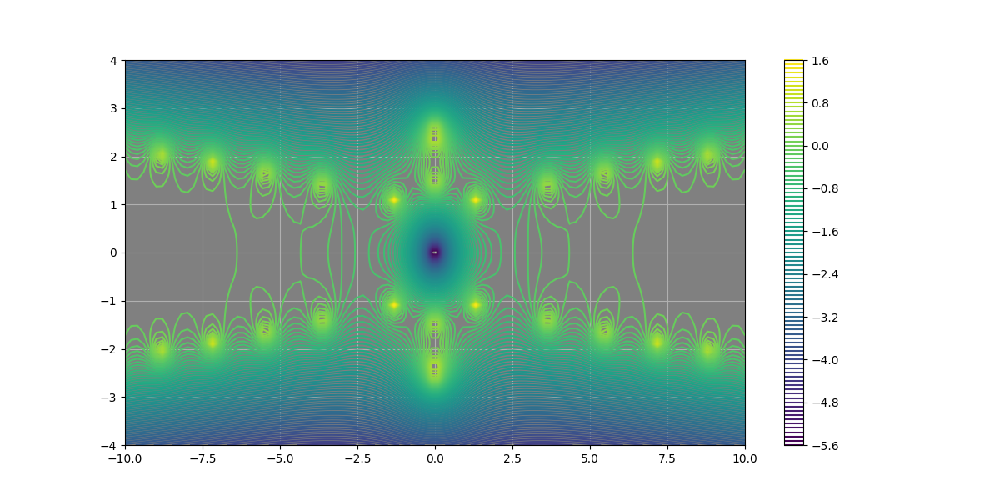

In [170]:
plotlogf(prodC, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True)

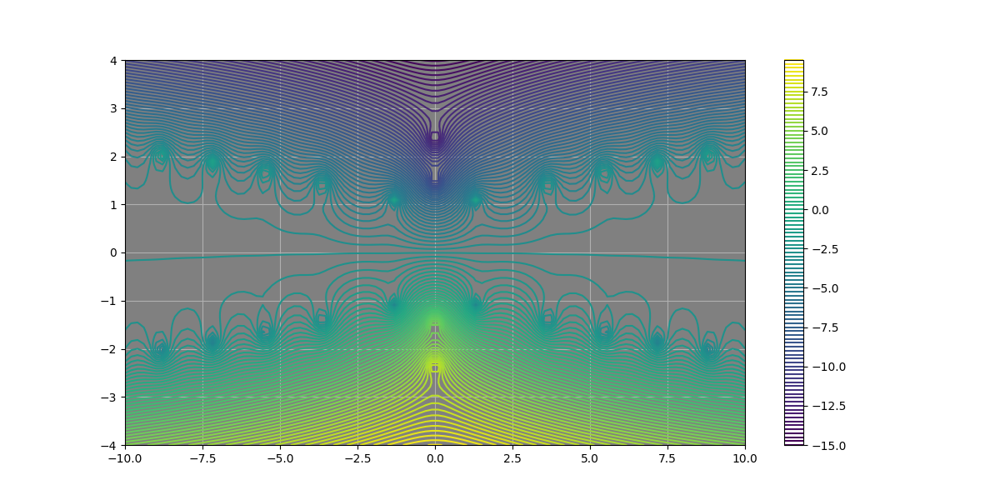

In [171]:
plotlogf(prodD, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True)

# M entries

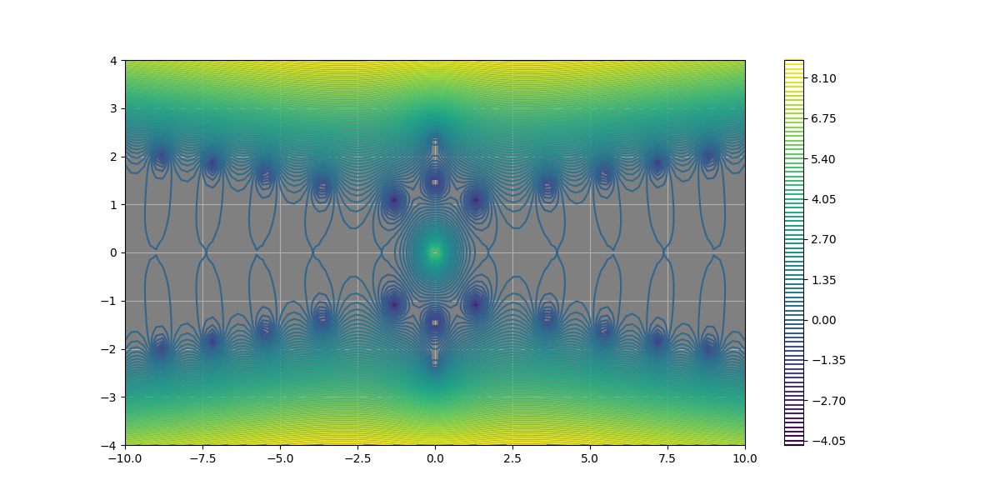

In [172]:
plotlogf(M_det, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True)

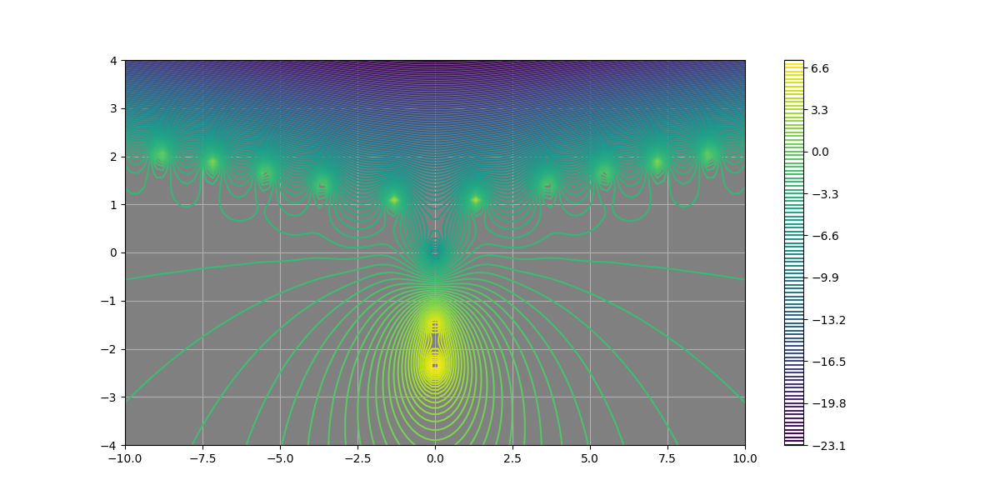

In [175]:
plotlogf(ratio, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True)

# Looks good!

This is more what I was hoping to see.  Let's look again at what I saw with other method.

In [186]:
S = np.array([[0, 1], [1, 0]])

def det_orthog(Z):
    Ca = A.coefficients_Z(Z, mode_type='radiation', sign='1').T
    Cb = A.coefficients_Z(Z, mode_type='radiation', sign='-1').T

    Naa = (Ca[0].T @ S @ Ca[0] + Ca[-1].T @ S @ Ca[-1])
    Nbb = (Cb[0].T @ S @ Cb[0] + Cb[-1].T @ S @ Cb[-1])
    Nab = (Ca[0].T @ S @ Cb[0] + Ca[-1].T @ S @ Cb[-1])

    return Naa * Nbb - Nab**2

def even_orthog(Z, sign='1'):
    Ca = A.coefficients_Z(Z, mode_type='radiation', sign=sign).T
    Naa = (Ca[0].T @ S @ Ca[0] + Ca[-1].T @ S @ Ca[-1])
    return Naa

def odd_orthog(Z, sign='-1'):
    Ca = A.coefficients_Z(Z, mode_type='radiation', sign=sign).T
    Naa = (Ca[0].T @ S @ Ca[0] + Ca[-1].T @ S @ Ca[-1])
    return Naa

def even_normed_version(Z):
    C = A.coefficients_Z(Z, mode_type='radiation', sign='1')
    v, w = C.T[0], C.T[-1]
    return np.linalg.norm(v)**2 + np.linalg.norm(w)**2  # This is not the same when M is not of form [[a,b.conj],[b, a.conj()]]

def odd_normed_version(Z):
    C = A.coefficients_Z(Z, mode_type='radiation', sign='-1')
    v, w = C.T[0], C.T[-1]
    return np.linalg.norm(v)**2 + np.linalg.norm(w)**2 

def left_coeffs(Z):
    Ca = A.coefficients_Z(Z, mode_type='radiation', sign='1').T
    Cb = A.coefficients_Z(Z, mode_type='radiation', sign='-1').T
    return Ca[0,0] * Ca[0,1] * Cb[0,0] * Cb[0,1]

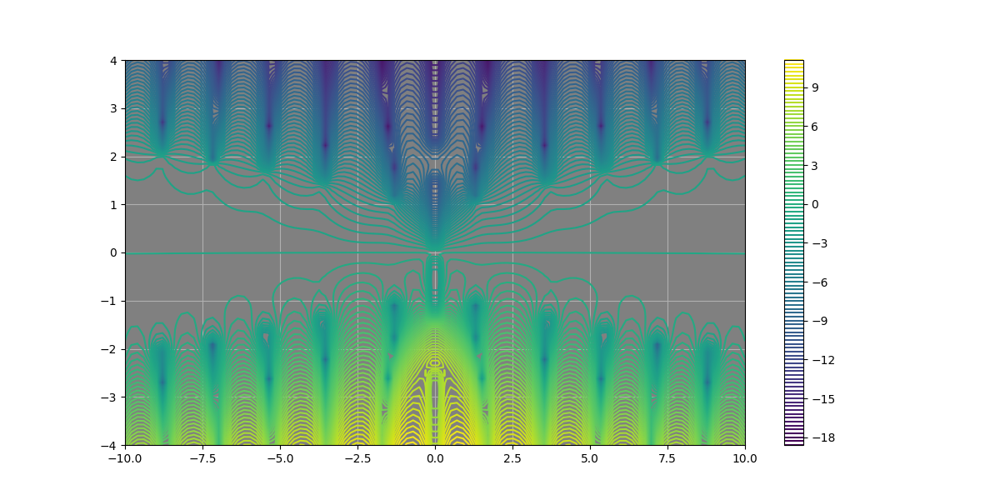

In [177]:
plotlogf(det_orthog, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True, loop=True)

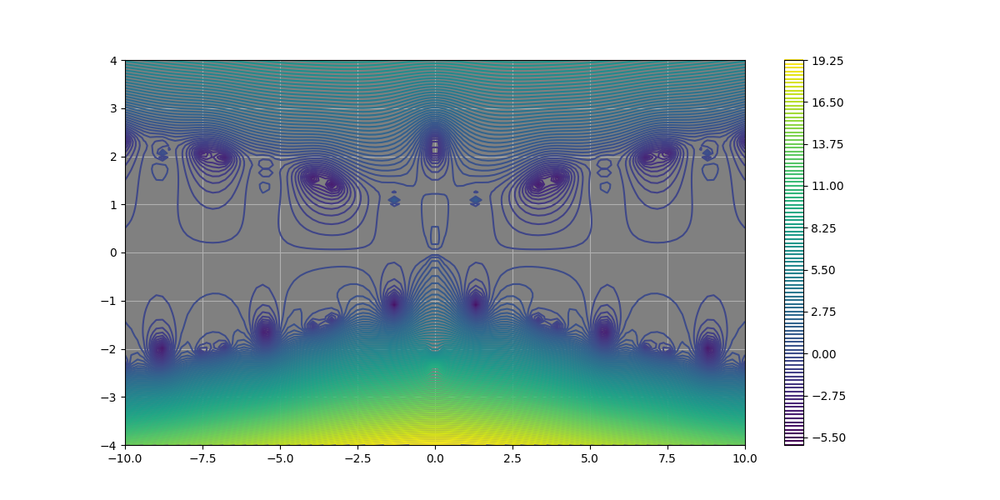

In [178]:
plt.close('all')
plotlogf(even_orthog, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True, loop=True)

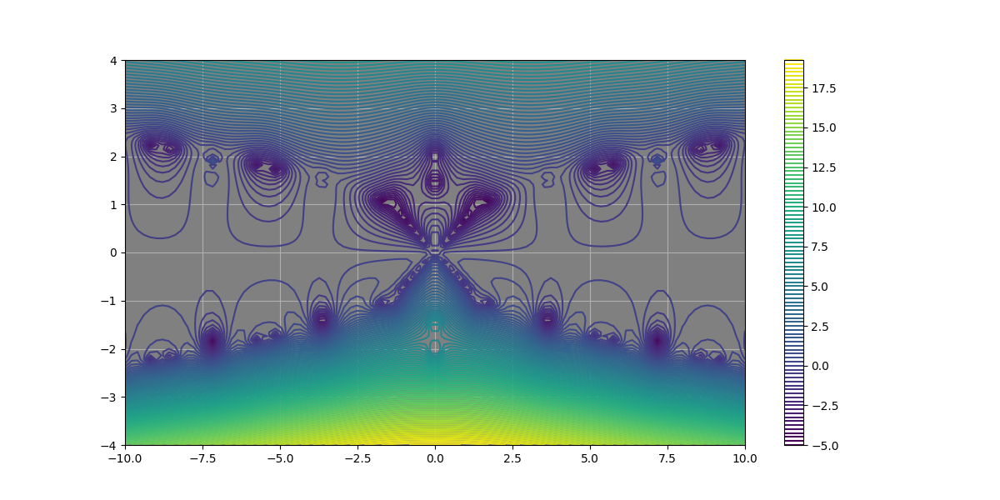

In [9]:
plt.close('all')
plotlogf(odd_orthog, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True, loop=True)

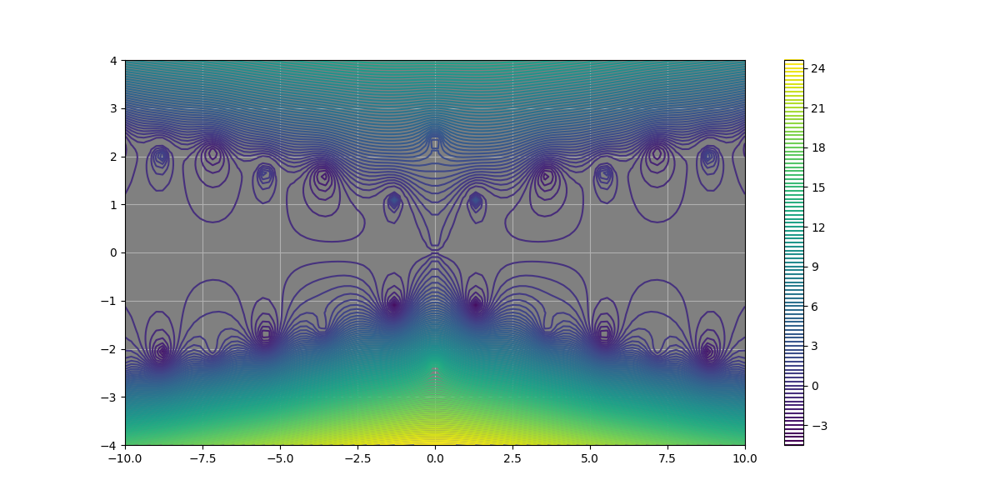

In [10]:
plotlogf(even_normed_version, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True, loop=True)

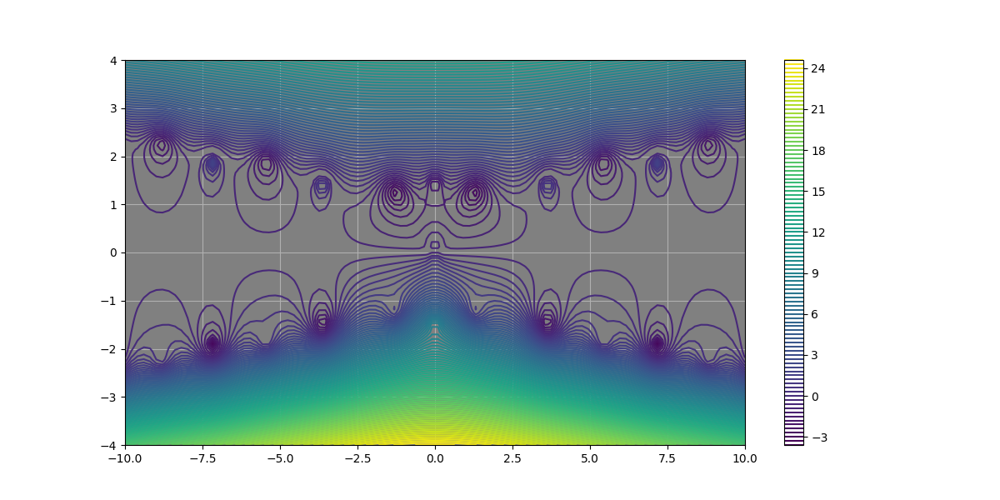

In [118]:
plotlogf(odd_normed_version, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True, loop=True)

That's ugly, but if we just look at the coefficients it's cool:


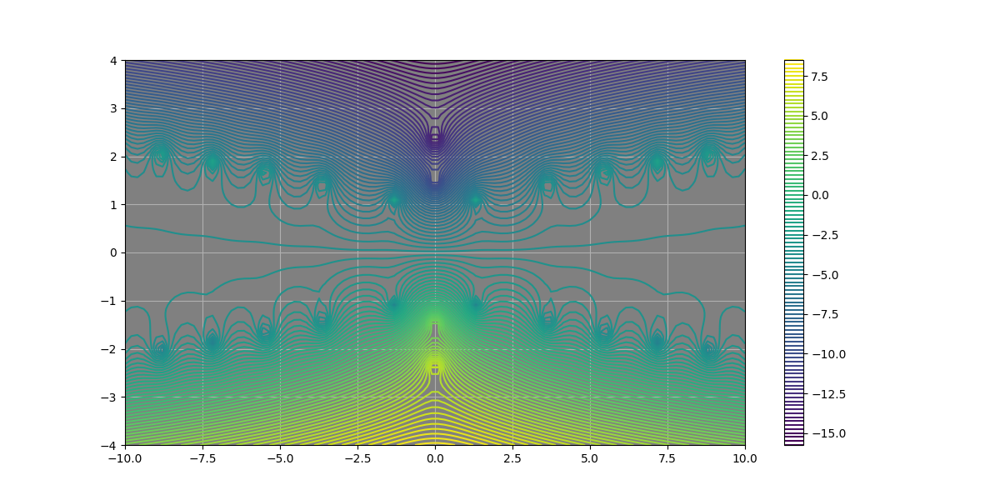

In [187]:
plotlogf(left_coeffs, -10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True, loop=True)

This is because we have already normalized and brought the determinant (of N) into the coefficients.  If we did this right though, the determinant of N should be constant and we shouldn't have the patterns we see above, so there is still something a bit off.

# Something is wrong on my end

Either the theory behind the term, or the implementation somehow is off.  This is a good debugging test case though.  Let's look at other way to get even and odd modes I know about

In [179]:

def otherway(Z):
    M = A.transmission_matrix_Z(Z)
    S = np.array([[0,1],[1,0]])
    MmS = M - S
    MpS = M + S

    ve = np.array([-MmS[..., 0,1], MmS[..., 0,0]]) * (-MmS[..., 0,1]+ MmS[..., 0,0]).conj()
    vo = np.array([-MpS[..., 0,1], MpS[..., 0,0]]) * (-MpS[..., 0,1]+ MpS[..., 0,0]).conj()
    we = S @ ve
    wo = S @ vo

    Nee = (ve.T @ S @ ve + we.T @ S @ we)
    Noo = (vo.T @ S @ vo + wo.T @ S @ wo)
    Neo = (vo.T @ S @ ve + wo.T @ S @ we)

    return Nee * Noo - Neo**2

def otherway_normed(Z, sign='1'):
    M = A.transmission_matrix_Z(Z)
    S = np.array([[0,1],[1,0]])
    MmS = M - S
    MpS = M + S

    ve = np.array([-MmS[..., 0,1], MmS[..., 0,0]]) * (-MmS[..., 0,1]+ MmS[..., 0,0]).conj()
    vo = np.array([-MpS[..., 0,1], MpS[..., 0,0]]) * (-MpS[..., 0,1]+ MpS[..., 0,0]).conj()
    return np.abs(ve[0])**2 + np.abs(vo[0])**2
    

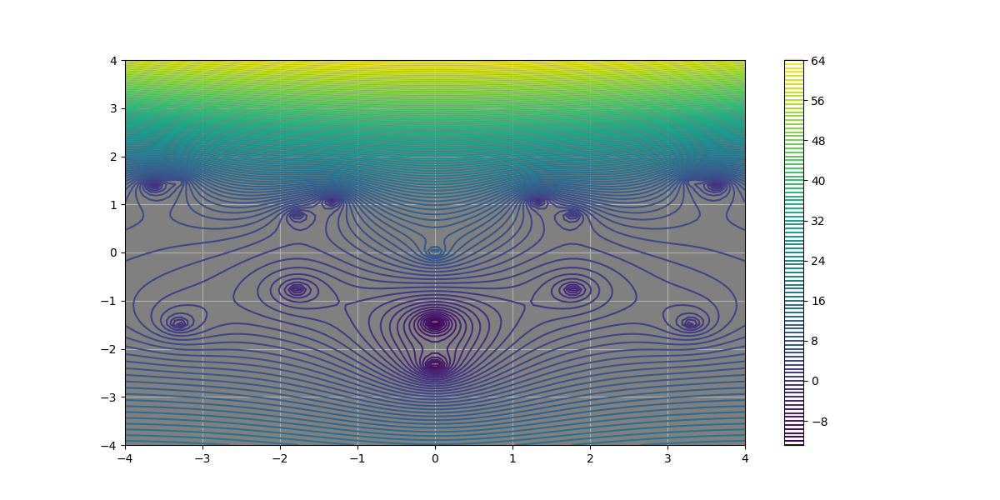

In [180]:
plt.close('all')
plotlogf(otherway,-4,4,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), loop=True)

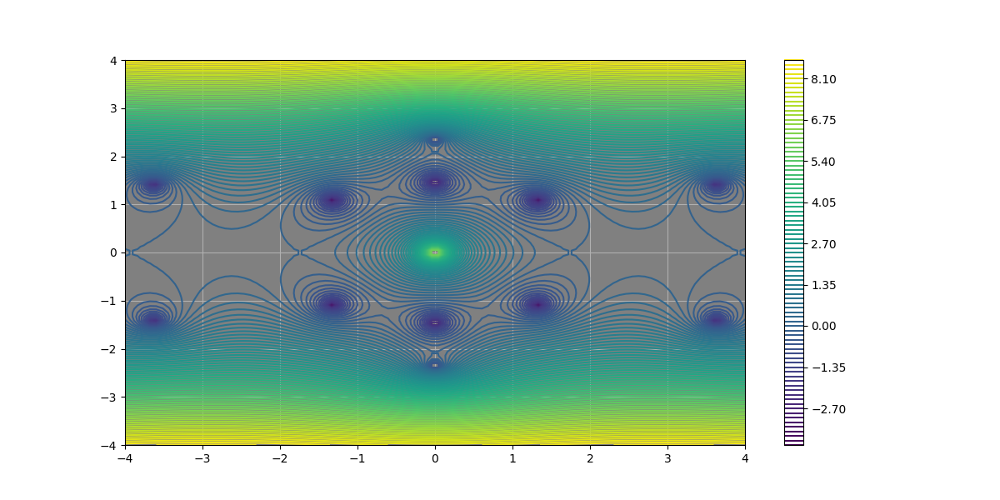

In [181]:
plotlogf(M_det, -4,4,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), colorbar=True)

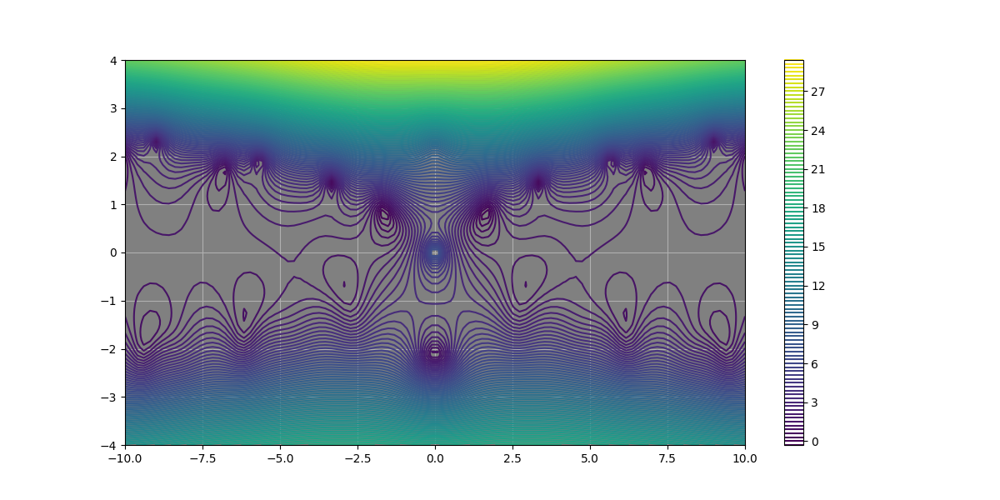

In [14]:
plotlogf(otherway_normed,-10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), loop=True)

Okay, so doing it otherway is still funky, which tends to indicate that the term itself might not be correct.  Interstingly, when we use a constant vector as the initial vector ( ie we provide a set c0 and c1), then the term works, as we see below:

In [15]:
S = np.array([[0, 1], [1, 0]])

def det_constant(Z, v1=np.array([1/2, 1/2]), v2=np.array([.5*1j, -.5*1j])):
    
    Ca = A.coefficients_Z(Z, c0=v1[0], c1=v1[1], mode_type='radiation').T
    Cb = A.coefficients_Z(Z, c0=v2[0], c1=v2[1], mode_type='radiation').T
    
    Naa = (Ca[0].T @ S @ Ca[0] + Ca[-1].T @ S @ Ca[-1])
    Nbb = (Cb[0].T @ S @ Cb[0] + Cb[-1].T @ S @ Cb[-1])
    Nab = (Ca[0].T @ S @ Cb[0] + Ca[-1].T @ S @ Cb[-1])
    
    return Naa * Nbb - Nab**2

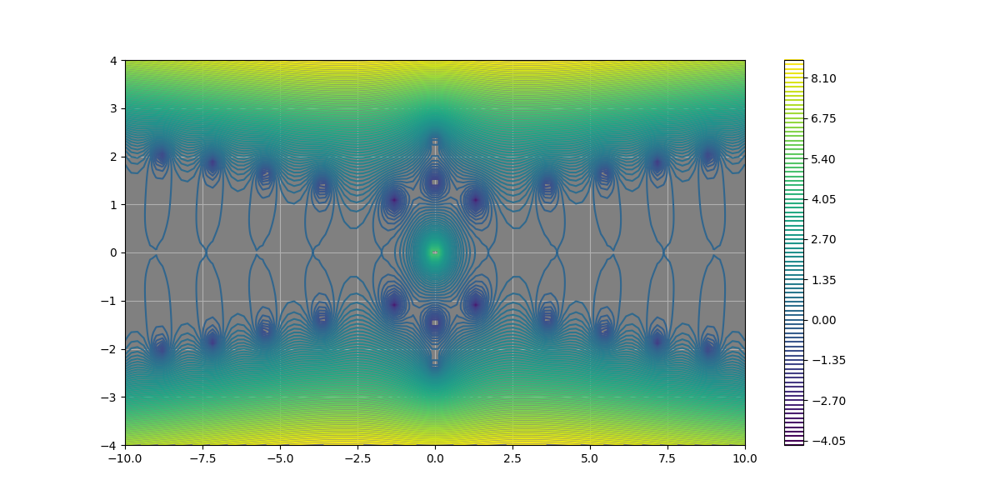

In [16]:
plotlogf(det_constant,-10,10,-4,4, rref=100, iref=100, levels=100,figsize=(12,6), loop=True)

Like, it's ridiculously beatiful and right on.  But then form the same terms using the method of the paper and we get the smear effect:

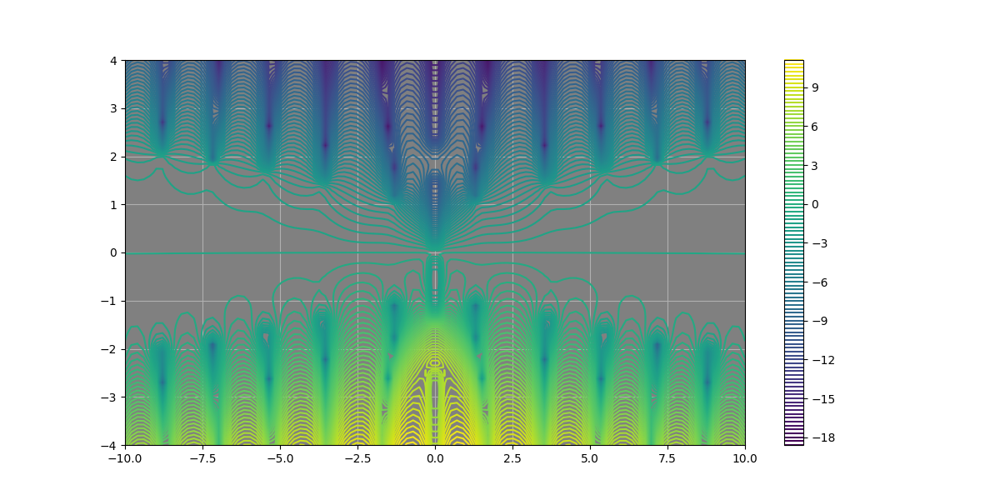

In [17]:
plotlogf(det_orthog, -10,10,-4,4, rref=100, iref=100, levels=100, figsize=(12,6), loop=True)

If we look at one of the smears, it reall is all zeros on that line, or at least appears so.

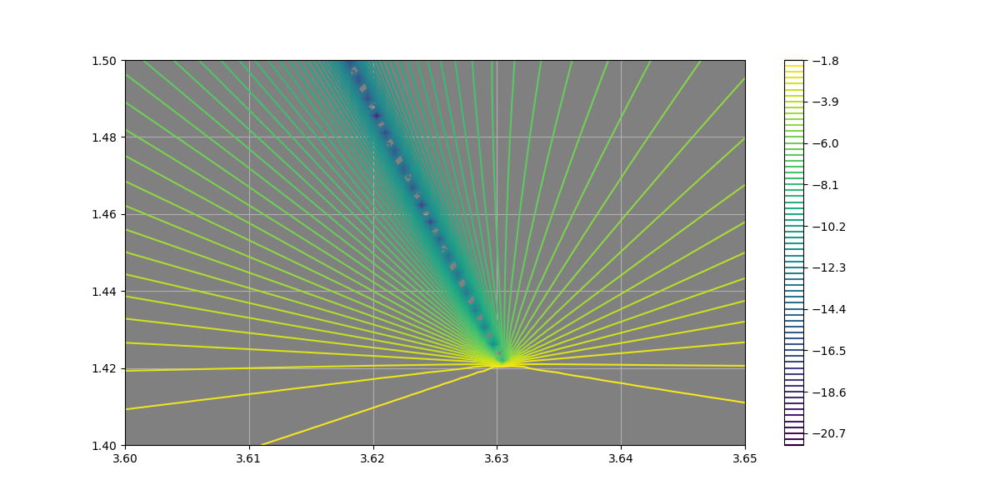

In [18]:
plotlogf(det_orthog, 3.6, 3.65,1.4, 1.5, rref=70, iref=70, levels=70, figsize=(12,6), loop=True)

And we know it's off anyway, since Marcuse's version worked perfectly.  Can we make the terms our way but use Marcuse's deriviation; that might be able to separate the issues.

# More general research

Not sure what I'll find.  Seems worth it to see if our coefficients from paper are related to Marcuse's

In [19]:
Z = 5 +2j
DeZ = De(Z)
FeZ = Fe(Z)
CeZ = 1/2*Ce(Z)
Cs = A.coefficients_Z(Z, mode_type='radiation').T
Cms = 1/(2*np.pi)**.5 * np.array([[DeZ, FeZ],[CeZ, CeZ],[FeZ, DeZ]])

In [20]:
(Cs/Cms)

array([[2.        +6.06054951e-14j, 0.95646346-2.88494949e-14j],
       [2.00138227-1.66553516e-03j, 2.4789432 +1.36794379e+00j],
       [3.523862  +1.36627825e+00j, 2.48032547+1.36627825e+00j]])

I would think we would want same scalar for all of them...  This seems to say that our method and Marcuse's don't line up...  Let's look at our field

In [21]:
FmZ = A.fields_Z(Z, mode_type='radiation', user_coeffs=Cms)
FZ = A.fields_Z(Z, mode_type='radiation')

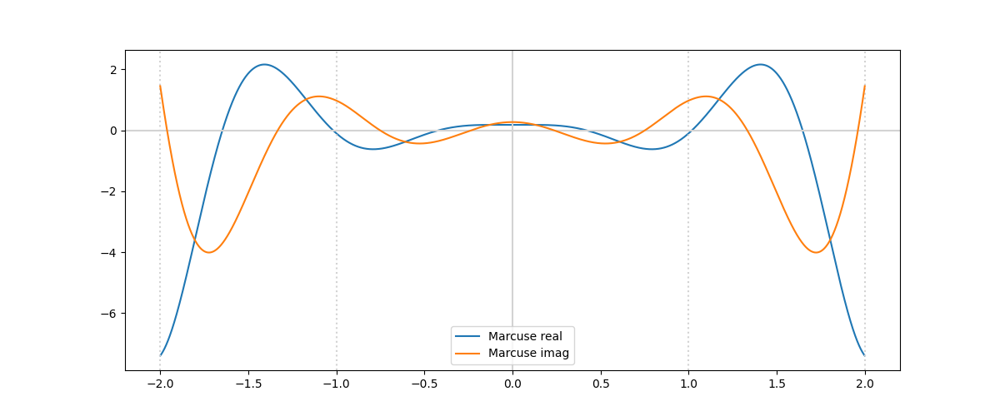

In [22]:
A.plot_field_1d(FmZ, xs=np.linspace(-2,2,10000), part='real', label='Marcuse real')
A.add_1d_plot(FmZ, xs=np.linspace(-2,2,10000), part='imag', label='Marcuse imag')
plt.legend();


Right, well that's a possible problem.  Maybe I didn't implement Marcuse's coefficients correctly....  No I basically did, but for some reason there is an extra 1/2 in De for him... 

Notably, Marcuse's coefficients don't give continuous fields at the interfaces when Z is not real...  The paper one's do, which isn't surprising as they are forcing that by using the transmission matrix.  Does this matter really?  Can we just let them be discontinuous outside of Z real?  Notably they are still even, which the paper's are not anymore.

Let's look at piecewise definitions directly from Marcuse, because there's no apparent reason this shouldn't be continuous.

In [23]:
A.K_low

4.537856055185257

In [24]:
Z=3+1j
Z_in = A.Zi_from_Z0(Z, A.ns[1])
Z_out = A.Zi_from_Z0(Z, A.ns[0])
Z_in, Z_out

((3.9252463704573684+0.7642832364813934j), (3+1j))

In [45]:
def Ey_inner(x):
    Coeff = Ce(Z, d=A.Rhos[2])
    return Coeff * np.cos(Z_in * x)

def Ey_outer(x):
    CoeffD = De(Z, d=A.Rhos[2])
    CoeffF = Fe(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* np.abs(x)) + CoeffF * np.exp(1j*Z_out* np.abs(x))

def Ey_right(x):
    CoeffD = De(Z, d=A.Rhos[2])
    CoeffF = Fe(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* x) + CoeffF * np.exp(1j*Z_out * x)

def Ey_left(x):
    CoeffD = De(Z, d=A.Rhos[2])
    CoeffF = Fe(Z, d=A.Rhos[2])
    return CoeffF * np.exp(-1j*Z_out * x) + CoeffD * np.exp(1j*Z_out * x)

def Ey_inner_odd(x):
    Coeff = Co(Z, d=A.Rhos[2])
    return Coeff * np.sin(Z_in * x)

def Ey_outer_odd(x):
    CoeffD = Do(Z, d=A.Rhos[2])
    CoeffF = Fo(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* np.abs(x)) + CoeffF * np.exp(1j*Z_out* np.abs(x))

def Ey_right_odd(x):
    CoeffD = Do(Z, d=A.Rhos[2])
    CoeffF = Fo(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* x) + CoeffF * np.exp(1j*Z_out * x)

def Ey_left_odd(x):
    CoeffD = Do(Z, d=A.Rhos[2])
    CoeffF = Fo(Z, d=A.Rhos[2])
    return -CoeffF * np.exp(-1j*Z_out * x) - CoeffD * np.exp(1j*Z_out * x)

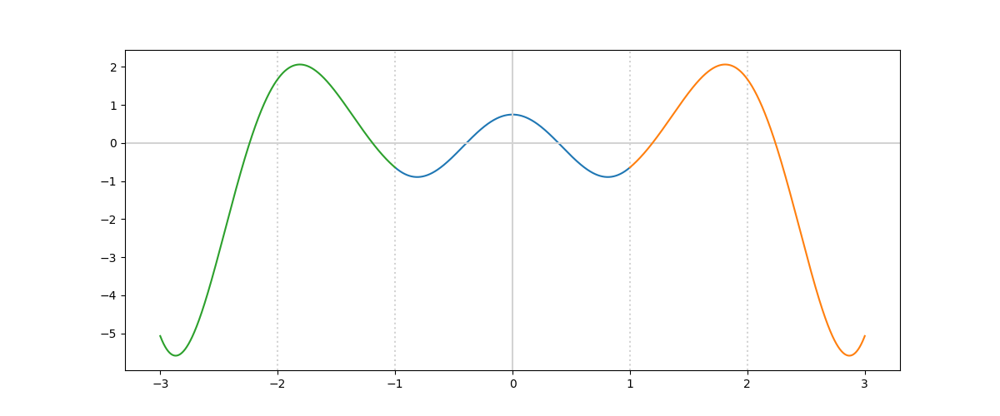

In [50]:
A.plot_field_1d(Ey_inner, xs=np.linspace(A.Rhos[1], A.Rhos[2], 3000))
A.add_1d_plot(Ey_right,  xs=np.linspace(A.Rhos[2],3, 3000))
A.add_1d_plot(Ey_left,  xs=np.linspace(-3, -A.Rhos[2], 3000))

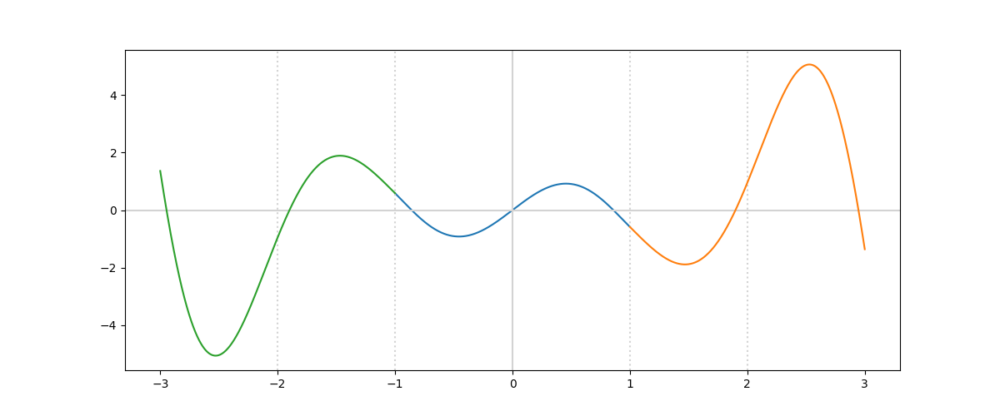

In [49]:
A.plot_field_1d(Ey_inner_odd, xs=np.linspace(A.Rhos[1], A.Rhos[2], 3000))
A.add_1d_plot(Ey_right_odd,  xs=np.linspace(A.Rhos[2],3, 3000))
A.add_1d_plot(Ey_left_odd,  xs=np.linspace(-3, -A.Rhos[2], 3000))

Right, it wasn't working because Fe = De.conj() only in case of real Z.  But we still have evenness of the fields regardless of Z being complex now that we've fixed that.  Let's look now though at what the complex plane plots look like.

In [84]:
prod_Cs = lambda z: (Ce(z) * Co(z))
prod_Ds = lambda z: (De(z) * Do(z))
prod_Fs = lambda z: (Fe(z) * Fo(z))


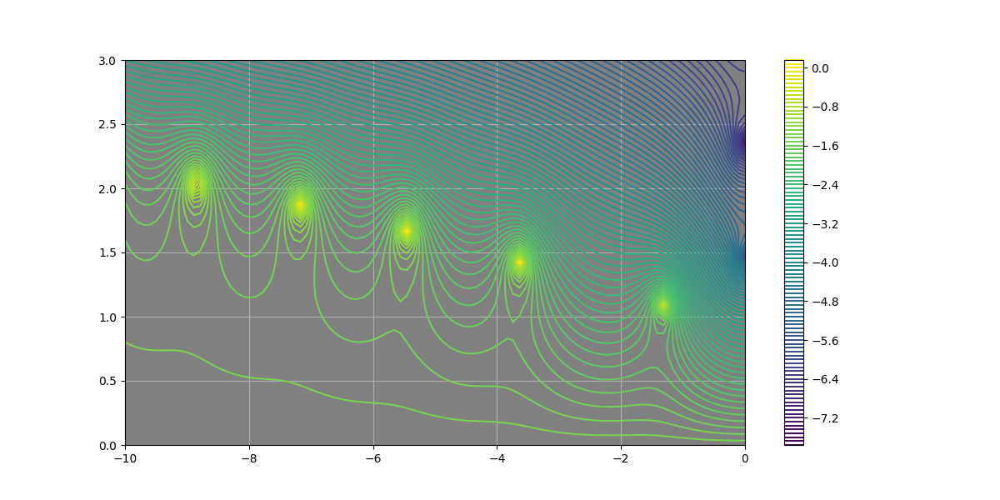

In [91]:
plt.close('all')
plotlogf(prod_Ds, -10, 0.001, 0, 3, rref=100, iref=100, levels=100, figsize=(12,6), loop=True)

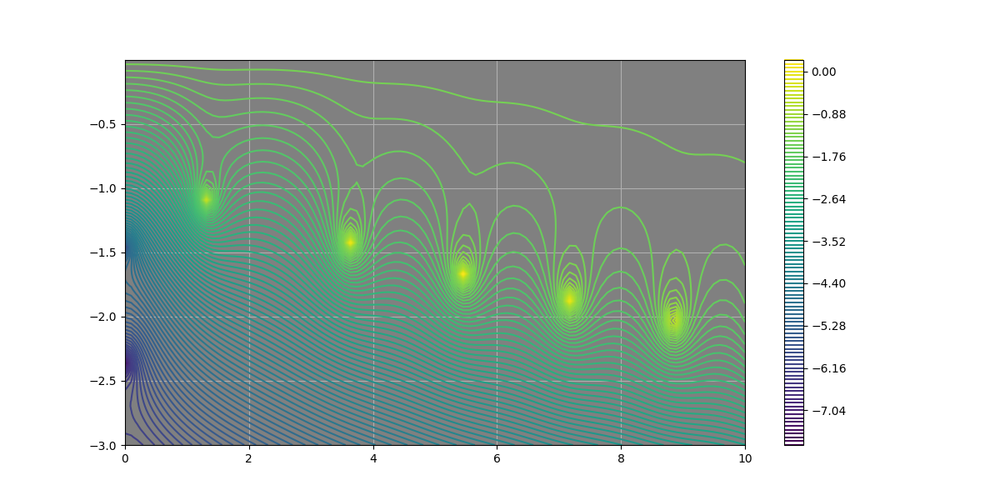

In [96]:
plotlogf(prod_Fs, 0,10, -0.001, -3, rref=100, iref=100, levels=100, figsize=(12,6), loop=True)

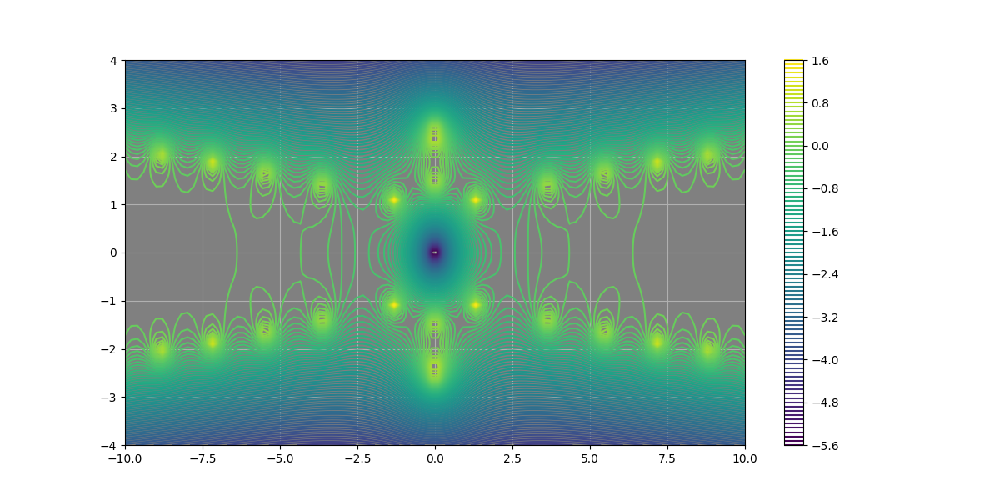

In [97]:
plotlogf(prod_Cs, -10,10,-4,4, rref=100, iref=100, levels=100, figsize=(12,6))

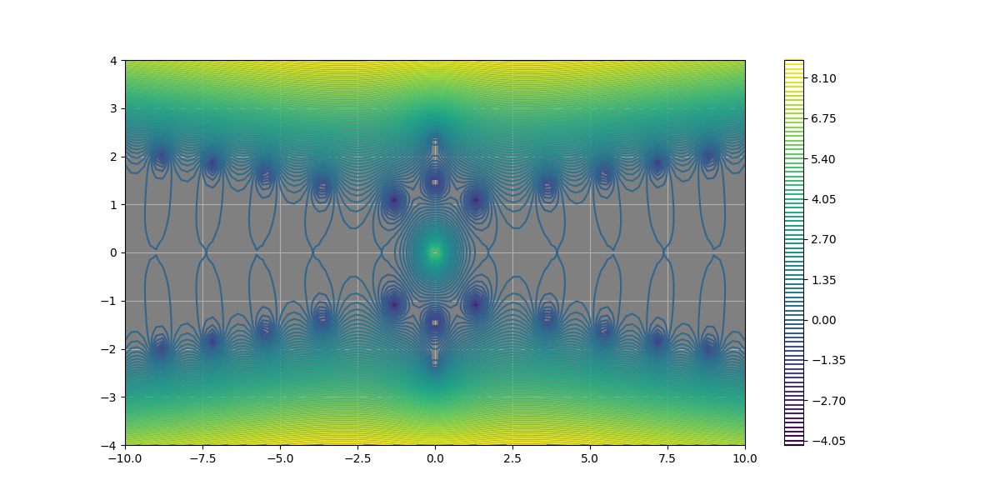

In [37]:
plotlogf(M_det, -10,10,-4,4, rref=100, iref=100, levels=100, figsize=(12,6))

# Conclusions

- Marcuse's method keeps modes even and odd even when going to complex plane for Z.  Paper method doesn't do this, only does even and odd for real Z.

- Resulting extensions to complex plane for normalized coefficients are very different for the two methods.  Marcuse has clear copy of roots of eigenequation as poles, paper method may have this, but has many more zeros and odd behavior.

- Would be good to see if we can fix paper method.  Seems like deformation of path in complex plane won't be possible using that method without a fix.

- Doesn't say or not say that I'm right in my main theorem.  I think it still holds.  In fact, plot below shows what det N would look like without normalizing that factor into Ce and Ce, and it shows there is a copy of M there.

In [157]:

def De2(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Debar = 1/2 * np.exp(1j*rho*d)*(np.cos(sigma*d) - 1j * (sigma/rho)*np.sin(sigma*d))
    return Debar*1

def Do2(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Debar = 1/2 * np.exp(1j*rho*d)*(np.sin(sigma*d) + 1j * (sigma/rho)*np.cos(sigma*d))
    return Debar*1

def Fe2(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Febar = 1/2 * np.exp(-1j*rho*d)*(np.cos(sigma*d) + 1j * (sigma/rho)*np.sin(sigma*d))
    return Febar*1

def Fo2(Z, d=A.Rhos[2]):
    rho = A.Zi_from_Z0(Z, A.ns[0])
    sigma = A.Zi_from_Z0(Z, A.ns[1])
    Fobar = 1/2 * np.exp(-1j*rho*d)*(np.sin(sigma*d) - 1j * (sigma/rho)*np.cos(sigma*d))
    return Fobar*1

def det2(Z, d=A.Rhos[2]):
    return De2(Z) * Fe2(Z) * Do2(Z) * Fo2(Z)

def ratio(Z):
    return det2(Z)/M_det(Z)

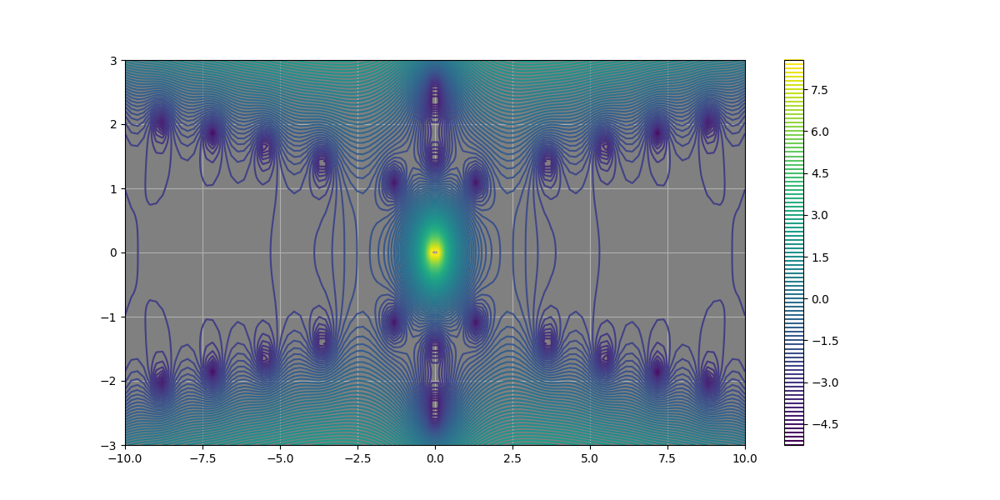

In [158]:
plotlogf(det2, -10,10,-3,3, rref=100, iref=100, levels=100, figsize=(12,6))

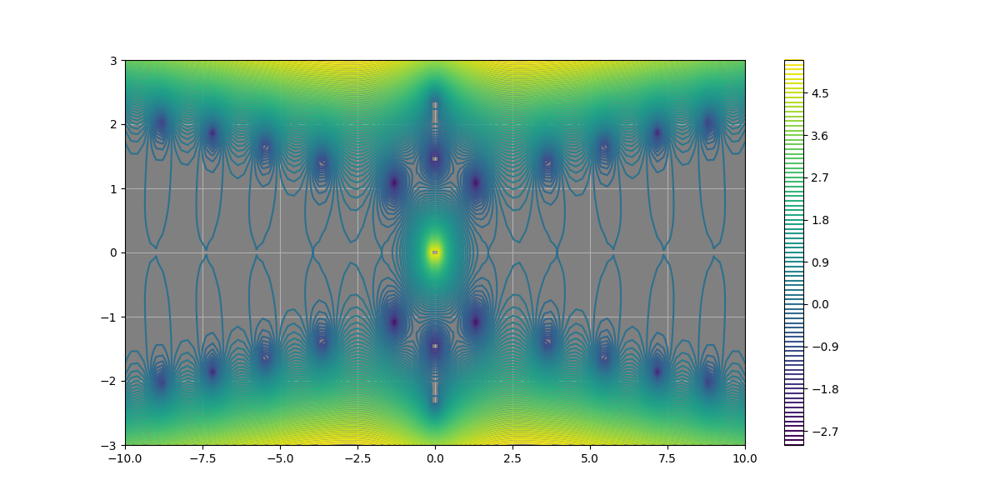

In [142]:
plotlogf(M_det, -10,10,-3,3, rref=100, iref=100, levels=100, figsize=(12,6))

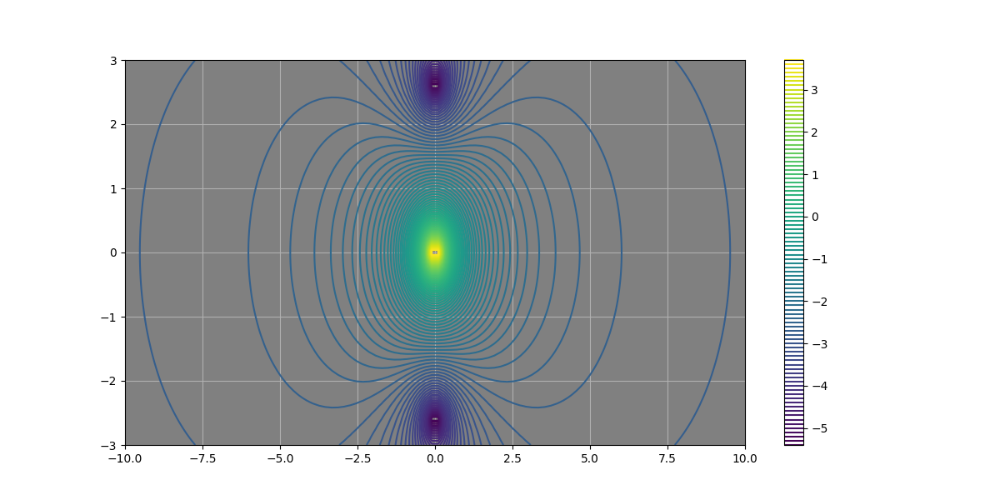

In [143]:
plotlogf(ratio, -10,10,-3,3, rref=100, iref=100, levels=100, figsize=(12,6))

In [149]:
Z_new = newton(ratio, np.array([3j]))
newton(M_det, np.array([2.612j])), newton(det2, np.array([2.8j]))

(array([4.09611704e-17+2.35731407j]), array([8.0478865e-20+2.61216964j]))

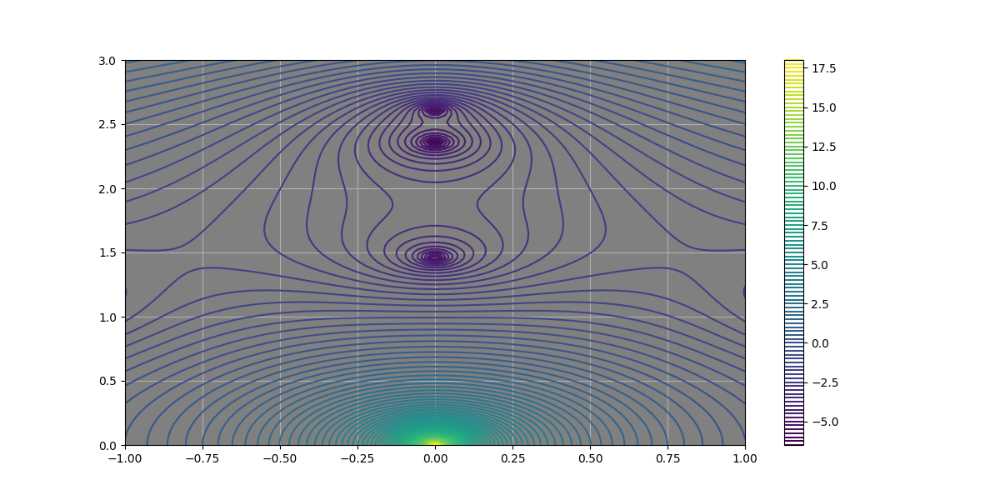

In [148]:
plt.close('all')
plotlogf(det2, -1,1,0, 3, rref=100, iref=100, levels=100, figsize=(12,6))

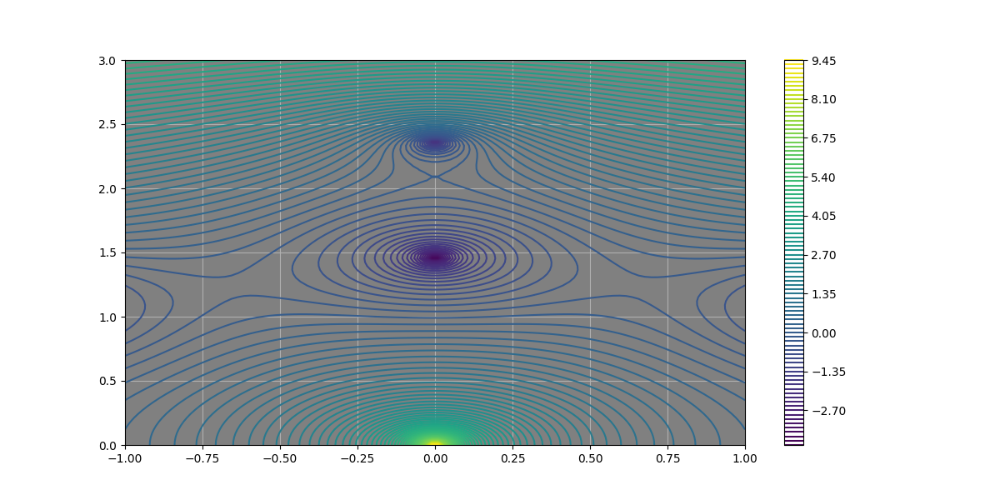

In [147]:
plt.close('all')
plotlogf(M_det, -1,1,0, 3, rref=100, iref=100, levels=100, figsize=(12,6))

# Further Conclusion

- We note that det N has a pure imaginary zero that does not appear in the entries of M00 or M11

In [150]:
Z=Z_new
Z_in = A.Zi_from_Z0(Z, A.ns[1])
Z_out = A.Zi_from_Z0(Z, A.ns[0])
Z_in, Z_out

(array([9.21761968e-10+5.38920396e-07j]), array([1.9017001e-16+2.61216964j]))

In [164]:
def Ey_inner(x):
    Coeff = Ce(Z, d=A.Rhos[2])
    return 1 * np.cos(Z_in * x)

def Ey_outer(x):
    CoeffD = De2(Z, d=A.Rhos[2])
    CoeffF = Fe2(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* np.abs(x)) + CoeffF * np.exp(1j*Z_out* np.abs(x))

def Ey_right(x):
    CoeffD = De2(Z, d=A.Rhos[2])
    CoeffF = Fe2(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* x) + CoeffF * np.exp(1j*Z_out * x)

def Ey_left(x):
    CoeffD = De2(Z, d=A.Rhos[2])
    CoeffF = Fe2(Z, d=A.Rhos[2])
    return CoeffF * np.exp(-1j*Z_out * x) + CoeffD * np.exp(1j*Z_out * x)

def Ey_inner_odd(x):
    Coeff = Co(Z, d=A.Rhos[2])
    return 1 * np.sin(Z_in * x)

def Ey_outer_odd(x):
    CoeffD = Do2(Z, d=A.Rhos[2])
    CoeffF = Fo2(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* np.abs(x)) + CoeffF * np.exp(1j*Z_out* np.abs(x))

def Ey_right_odd(x):
    CoeffD = Do2(Z, d=A.Rhos[2])
    CoeffF = Fo2(Z, d=A.Rhos[2])
    return CoeffD * np.exp(-1j*Z_out* x) + CoeffF * np.exp(1j*Z_out * x)

def Ey_left_odd(x):
    CoeffD = Do2(Z, d=A.Rhos[2])
    CoeffF = Fo2(Z, d=A.Rhos[2])
    return -CoeffF * np.exp(-1j*Z_out * x) - CoeffD * np.exp(1j*Z_out * x)

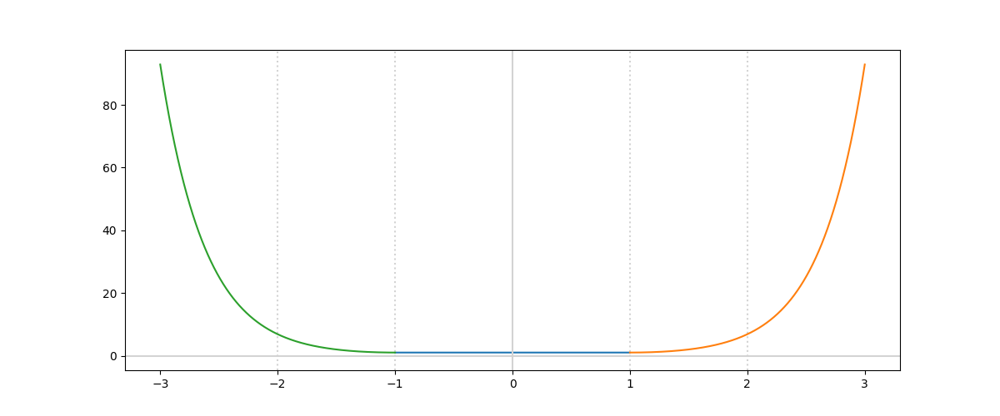

In [165]:
A.plot_field_1d(Ey_inner, xs=np.linspace(A.Rhos[1], A.Rhos[2], 3000))
A.add_1d_plot(Ey_right,  xs=np.linspace(A.Rhos[2],3, 3000))
A.add_1d_plot(Ey_left,  xs=np.linspace(-3, -A.Rhos[2], 3000))

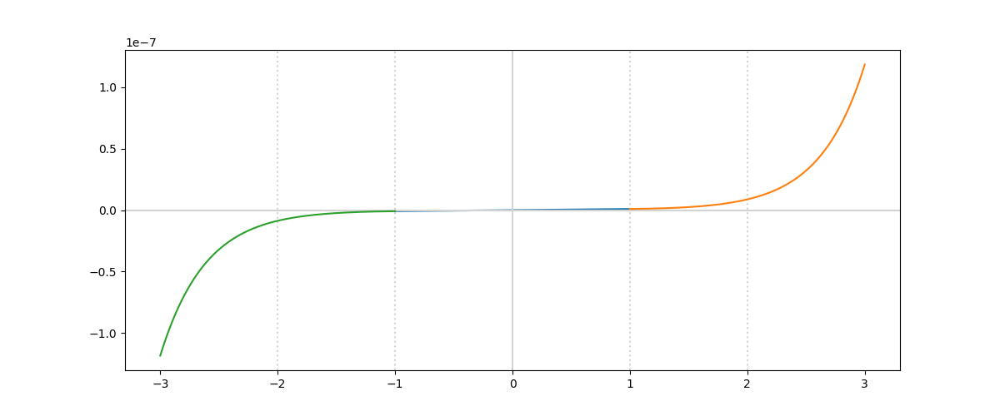

In [166]:
A.plot_field_1d(Ey_inner_odd, xs=np.linspace(A.Rhos[1], A.Rhos[2], 3000))
A.add_1d_plot(Ey_right_odd,  xs=np.linspace(A.Rhos[2],3, 3000))
A.add_1d_plot(Ey_left_odd,  xs=np.linspace(-3, -A.Rhos[2], 3000))